--------------------------------------------------
RESULTS AFTER EPOCH 1268 (weights [-0.0127662  -0.04689478  0.27967391])
[Data 0, Neuron Output 0] expected: -1 got: -0.012519124817183973 data: [1 1]
[Data 1, Neuron Output 0] expected: 1 got: 0.003595268575050047 data: [ 1 -1]
[Data 2, Neuron Output 0] expected: 1 got: -0.003129336038217759 data: [-1  1]
[Data 3, Neuron Output 0] expected: -1 got: 0.012382186560624757 data: [-1 -1]
--------------------------------------------------
RESULTS AFTER EPOCH 1272 (weights [-0.01277449 -0.04688896  0.27986787])
[Data 0, Neuron Output 0] expected: -1 got: -0.012522377022361428 data: [1 1]
[Data 1, Neuron Output 0] expected: 1 got: 0.0035957998737852766 data: [ 1 -1]
[Data 2, Neuron Output 0] expected: 1 got: -0.0031295987441168844 data: [-1  1]
[Data 3, Neuron Output 0] expected: -1 got: 0.01238494140399419 data: [-1 -1]
--------------------------------------------------
RESULTS AFTER EPOCH 1276 (weights [-0.01278271 -0.04688356  0.28006207])

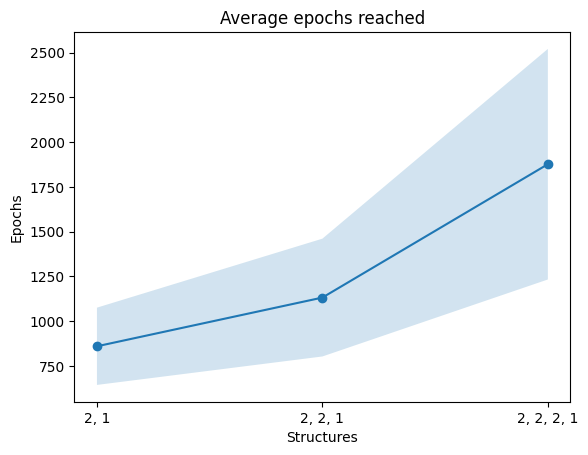

Run model - 3 - [2, 1]  started
--------------------------------------------------
RESULTS AFTER EPOCH 4 (weights [-0.08713934  0.21761334 -0.28444655])
[Data 0, Neuron Output 0] expected: -1 got: -0.184545377158527 data: [1 1]
[Data 1, Neuron Output 0] expected: 1 got: -0.14995021636959185 data: [ 1 -1]
[Data 2, Neuron Output 0] expected: 1 got: -0.1425869308111658 data: [-1  1]
[Data 3, Neuron Output 0] expected: -1 got: -0.10701580144640908 data: [-1 -1]
--------------------------------------------------
RESULTS AFTER EPOCH 8 (weights [-0.01869451  0.19462125 -0.29111756])
[Data 0, Neuron Output 0] expected: -1 got: -0.09726771602393962 data: [1 1]
[Data 1, Neuron Output 0] expected: 1 got: -0.055336149978783174 data: [ 1 -1]
[Data 2, Neuron Output 0] expected: 1 got: -0.06236219954436229 data: [-1  1]
[Data 3, Neuron Output 0] expected: -1 got: -0.019323805873916057 data: [-1 -1]
--------------------------------------------------
RESULTS AFTER EPOCH 12 (weights [ 0.00835133  0.1840

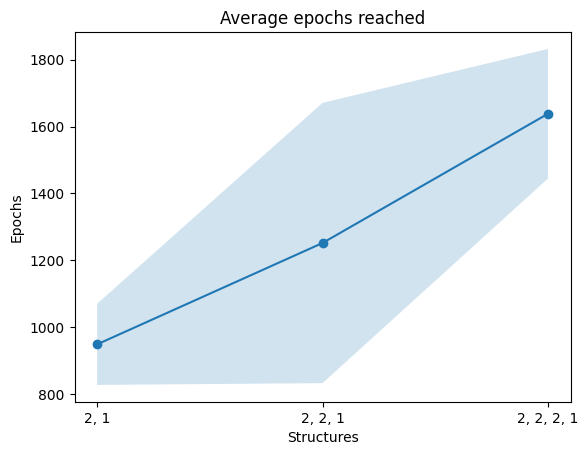

Run model - 3 - [2, 1]  started
--------------------------------------------------
RESULTS AFTER EPOCH 4 (weights [ 0.15444563 -0.1547817   0.02731833])
[Data 0, Neuron Output 0] expected: -1 got: 0.28682308032252746 data: [1 1]
[Data 1, Neuron Output 0] expected: 1 got: 0.17642810376353718 data: [ 1 -1]
[Data 2, Neuron Output 0] expected: 1 got: 0.33186782009371146 data: [-1  1]
[Data 3, Neuron Output 0] expected: -1 got: 0.2426178719288871 data: [-1 -1]
--------------------------------------------------
RESULTS AFTER EPOCH 8 (weights [ 0.04488336 -0.08723564 -0.01829249])
[Data 0, Neuron Output 0] expected: -1 got: 0.10573796653584551 data: [1 1]
[Data 1, Neuron Output 0] expected: 1 got: 0.04040779747842096 data: [ 1 -1]
[Data 2, Neuron Output 0] expected: 1 got: 0.12695434520326415 data: [-1  1]
[Data 3, Neuron Output 0] expected: -1 got: 0.07452712515954071 data: [-1 -1]
--------------------------------------------------
RESULTS AFTER EPOCH 12 (weights [ 0.01281884 -0.04568407 -0.

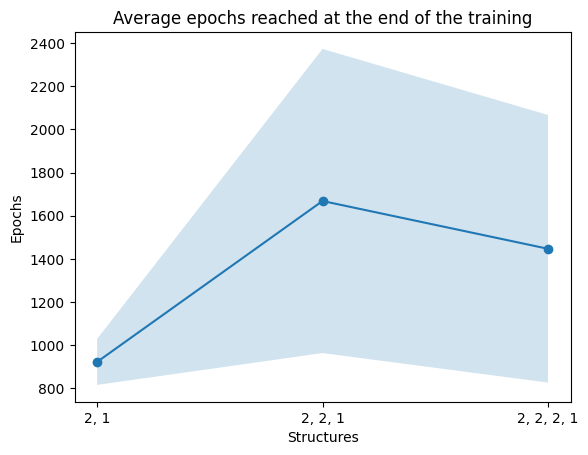

In [9]:
from tp3.src.trainer import TrainerConfig
from src.runner_3a import run_by_layers
import numpy as np
import matplotlib.pyplot as plt

'''
    Average Epochs reached on training by multilayer model
'''

config = TrainerConfig.from_file("ejercicio3-a-config.json")

models = [[2, 1], [2, 2, 1], [2, 2, 2, 1]]
means_arrays = [[], [], []]
n=5

means = []
stdevs = []
labels = ["2, 1", "2, 2, 1", "2, 2, 2, 1"]

for i, model in enumerate(models):
    while len(means_arrays[i]) < n:
        result = run_by_layers(f'model - {len(means_arrays)} - {model} ', model, config)
        if result["has_converged"]:
            print(f"Run {result['name']} converged in {result['epochs']} epochs")
            means_arrays[i].append(result['epochs'])
    means.append(np.mean(means_arrays[i]))
    stdevs.append(np.std(means_arrays[i]))

x = np.linspace(0, len(models) - 1, num=len(models))
plt.plot(x, means, marker='o')
plt.fill_between(x, np.array(means) - np.array(stdevs), np.array(means) + np.array(stdevs), alpha=0.2)
plt.xlabel("Structures")
plt.ylabel("Epochs")
plt.xticks(x, labels)
plt.title("Average epochs reached at the end of the training")
plt.show()